# **Run YOLOv7 on Cloud GPU**

YOLOV7 is the latest edition of popular YOLO algorithm specifically designed for industry applications. It achieves high mAP with amazing fps.


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
%%bash
cd /content/gdrive/MyDrive/yolov7
git clone https://github.com/WongKinYiu/yolov7.git
cd yolov7
wget https://raw.githubusercontent.com/WongKinYiu/yolov7/u5/requirements.txt
pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


fatal: destination path 'yolov7' already exists and is not an empty directory.
--2022-10-04 04:36:28--  https://raw.githubusercontent.com/WongKinYiu/yolov7/u5/requirements.txt
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1032 (1.0K) [text/plain]
Saving to: ‘requirements.txt.4’

     0K .                                                     100% 44.5M=0s

2022-10-04 04:36:29 (44.5 MB/s) - ‘requirements.txt.4’ saved [1032/1032]



In [ ]:
import os
import sys
sys.path.append('/content/gdrive/MyDrive/yolov7/yolov7')

In [ ]:
%cd /content/gdrive/MyDrive/yolov7/yolov7

/content/gdrive/MyDrive/yolov7/yolov7


In [ ]:
if not os.path.isdir("/content/gdrive/MyDrive/yolov7/yolov7/weights"):
  os.makedirs("/content/gdrive/MyDrive/yolov7/yolov7/weights")

In [ ]:
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


# 1.3 Getting YOLOv7 Models

In [ ]:
%%bash
wget -P /content/gdrive/MyDrive/yolov7/yolov7/weights https://github.com/WongKinYiu/yolov7/releases/download/v0.1/yolov7.pt
wget -P /content/gdrive/MyDrive/yolov7/yolov7/weights https://github.com/WongKinYiu/yolov7/releases/download/v0.1/yolov7x.pt
wget -P /content/gdrive/MyDrive/yolov7/yolov7/weights https://github.com/WongKinYiu/yolov7/releases/download/v0.1/yolov7-w6.pt
wget -P /content/gdrive/MyDrive/yolov7/yolov7/weights https://github.com/WongKinYiu/yolov7/releases/download/v0.1/yolov7-e6.pt
wget -P /content/gdrive/MyDrive/yolov7/yolov7/weights https://github.com/WongKinYiu/yolov7/releases/download/v0.1/yolov7-d6.pt
wget -P /content/gdrive/MyDrive/yolov7/yolov7/weights https://github.com/WongKinYiu/yolov7/releases/download/v0.1/yolov7-e6e.pt

In [ ]:
%cd /content/gdrive/MyDrive/yolov7/yolov7
!pip install roboflow


from roboflow import Roboflow
rf = Roboflow(api_key="*******")
project = rf.workspace("ruhad").project("tea_disease")
dataset = project.version(1).download("yolov7")

In [ ]:
%cat /content/gdrive/MyDrive/yolov7/yolov7/Tea_Disease-1/data.yaml

names:
- Black rot of tea
- Brown blight of tea
- Leaf rust of tea
- Red Spider infested tea leaf
- Tea Mosquito bug infested leaf
- Tea leaf
- White spot of tea
- disease
nc: 8
train: Tea_Disease-1/train/images
val: Tea_Disease-1/valid/images


In [ ]:
import torch
torch.cuda.empty_cache()


In [ ]:
torch.cuda.memory_summary(device=None, abbreviated=False)

'|===========================================================================|\n|                  PyTorch CUDA memory summary, device ID 0                 |\n|---------------------------------------------------------------------------|\n|            CUDA OOMs: 0            |        cudaMalloc retries: 0         |\n|===========================================================================|\n|        Metric         | Cur Usage  | Peak Usage | Tot Alloc  | Tot Freed  |\n|---------------------------------------------------------------------------|\n| Allocated memory      |       0 B  |       0 B  |       0 B  |       0 B  |\n|       from large pool |       0 B  |       0 B  |       0 B  |       0 B  |\n|       from small pool |       0 B  |       0 B  |       0 B  |       0 B  |\n|---------------------------------------------------------------------------|\n| Active memory         |       0 B  |       0 B  |       0 B  |       0 B  |\n|       from large pool |       0 B  |       0 B  |

In [ ]:
%%time
%cd /content/gdrive/MyDrive/yolov7/yolov7
!python train.py --batch 16 --cfg cfg/training/yolov7.yaml --epochs 150 --data Tea_Disease-1/data.yaml --weights 'weights/yolov7.pt' --device 0

/content/gdrive/MyDrive/yolov7/yolov7
YOLOR 🚀 v0.1-65-gb3c4165 torch 1.12.1+cu113 CUDA:0 (Tesla P100-PCIE-16GB, 16280.875MB)

Namespace(adam=False, artifact_alias='latest', batch_size=16, bbox_interval=-1, bucket='', cache_images=False, cfg='cfg/training/yolov7.yaml', data='Tea_Disease-1/data.yaml', device='0', entity=None, epochs=150, evolve=False, exist_ok=False, global_rank=-1, hyp='data/hyp.scratch.p5.yaml', image_weights=False, img_size=[640, 640], label_smoothing=0.0, linear_lr=False, local_rank=-1, multi_scale=False, name='exp', noautoanchor=False, nosave=False, notest=False, project='runs/train', quad=False, rect=False, resume=False, save_dir='runs/train/exp', save_period=-1, single_cls=False, sync_bn=False, total_batch_size=16, upload_dataset=False, weights='weights/yolov7.pt', workers=8, world_size=1)
tensorboard: Start with 'tensorboard --logdir runs/train', view at http://localhost:6006/
hyperparameters: lr0=0.01, lrf=0.1, momentum=0.937, weight_decay=0.0005, warmup_epochs=

In [ ]:
%cd /content/gdrive/MyDrive/yolov7/yolov7
!python test.py --data Tea_Disease-1/data.yaml --batch 16 --conf 0.3 --device 0 --weights runs/train/exp/weights/best.pt --name yolov7_testing

/content/gdrive/MyDrive/yolov7/yolov7
Namespace(augment=False, batch_size=16, conf_thres=0.3, data='Tea_Disease-1/data.yaml', device='0', exist_ok=False, img_size=640, iou_thres=0.65, name='yolov7_testing', no_trace=False, project='runs/test', save_conf=False, save_hybrid=False, save_json=False, save_txt=False, single_cls=False, task='val', verbose=False, weights=['runs/train/exp/weights/best.pt'])
YOLOR 🚀 v0.1-65-gb3c4165 torch 1.12.1+cu113 CUDA:0 (A100-SXM4-40GB, 40536.1875MB)

Fusing layers... 
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
RepConv.fuse_repvgg_block
IDetect.fuse
Model Summary: 314 layers, 36519530 parameters, 6194944 gradients
 Convert model to Traced-model... 
 traced_script_module saved! 
 model is traced! 

/usr/local/lib/python3.7/dist-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2894.)
  return _VF.m

/content/gdrive/MyDrive/yolov7/yolov7


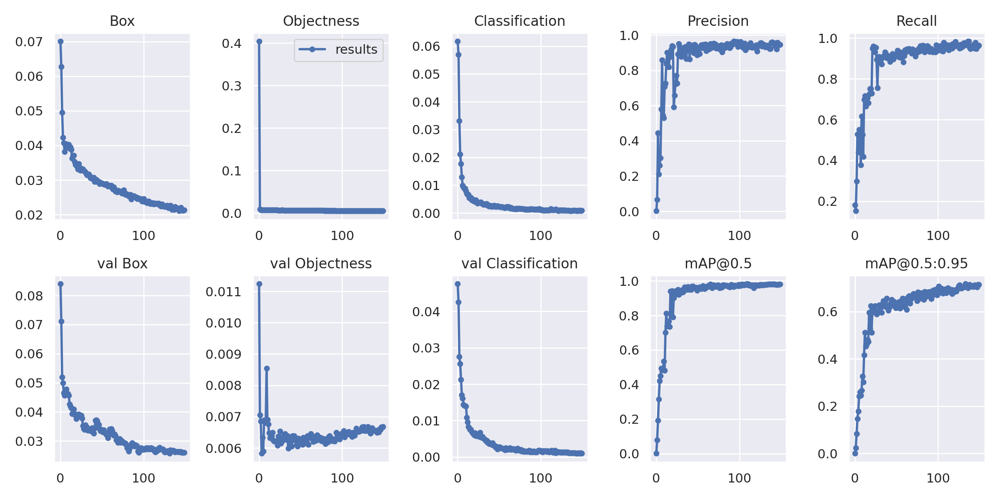

In [ ]:
%cd /content/gdrive/MyDrive/yolov7/yolov7
from IPython.display import Image
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/gdrive/MyDrive/yolov7/yolov7/runs/train/exp/results.png', width=900)  # view results.png

GROUND TRUTH TRAINING DATA:


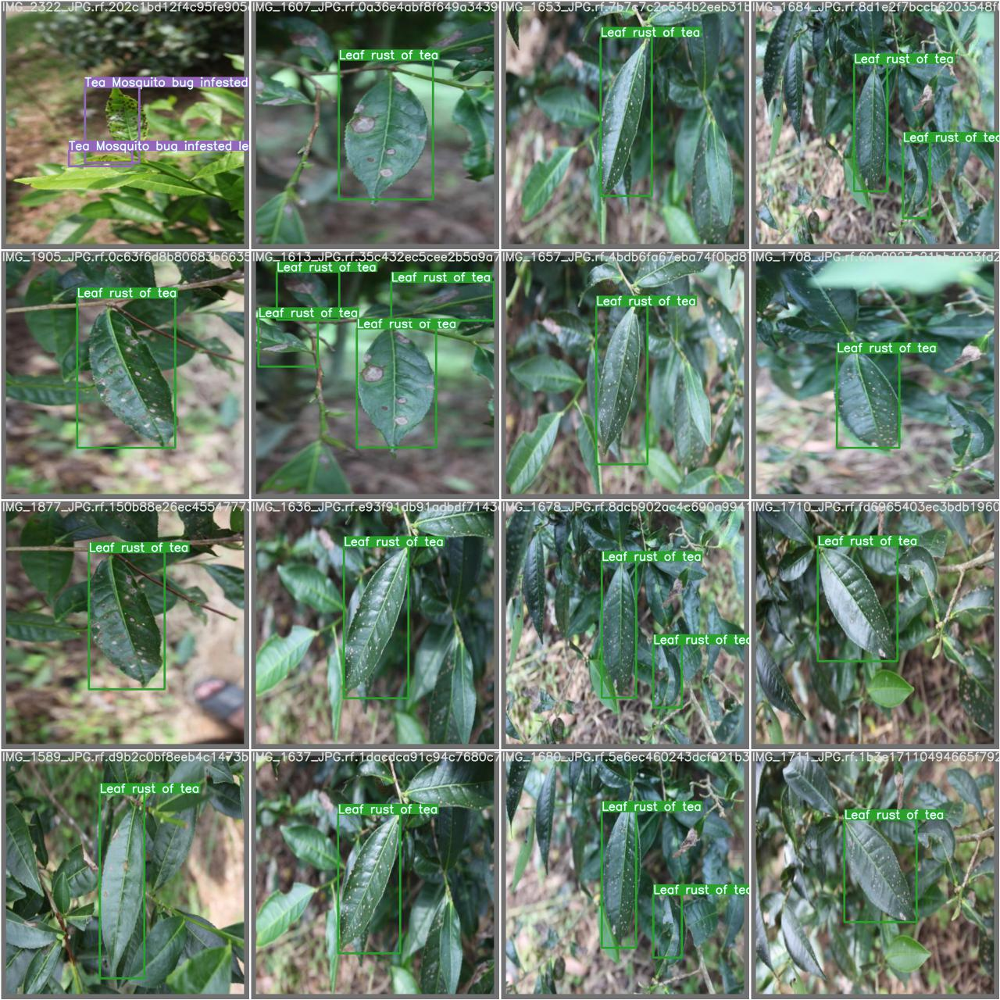

In [ ]:
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/gdrive/MyDrive/yolov7/yolov7/runs/train/exp/test_batch1_labels.jpg', width=500)

In [ ]:
%cd /content/gdrive/MyDrive/yolov7/yolov7
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.3 --source Tea_Disease-1/test/images

/content/gdrive/MyDrive/yolov7/yolov7


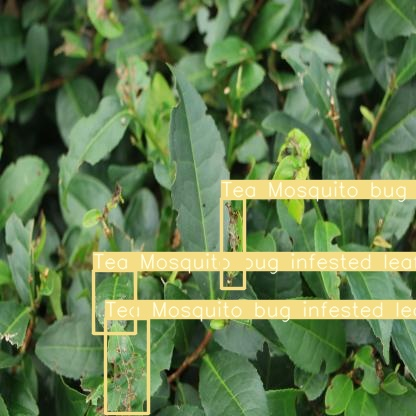

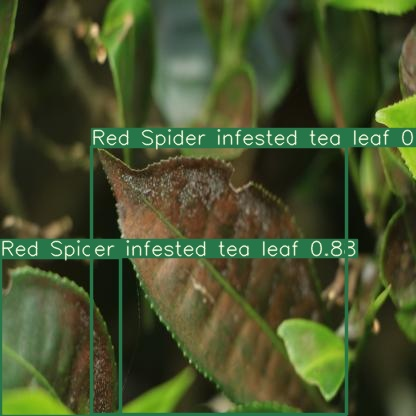

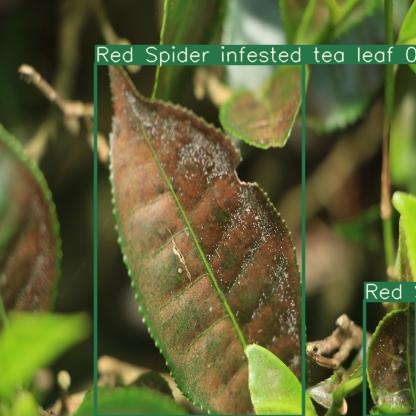

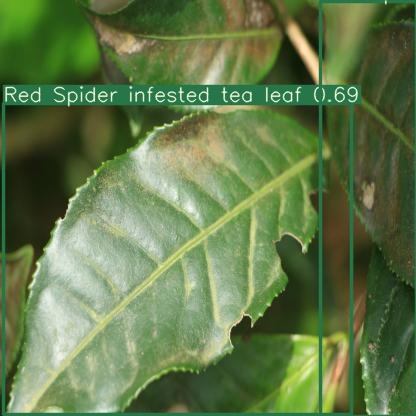

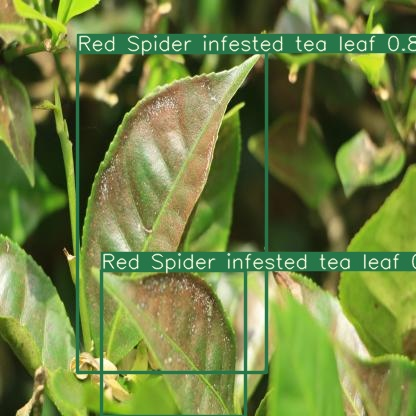

...

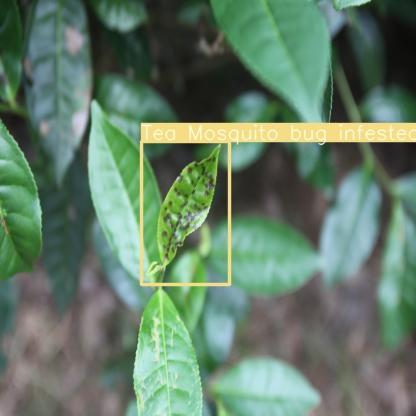

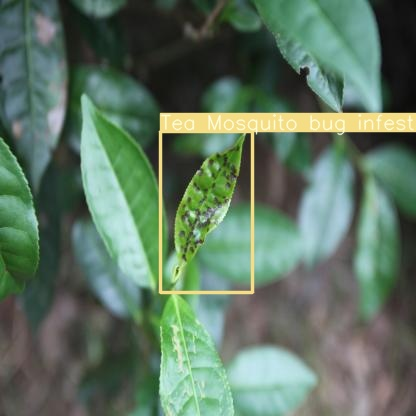

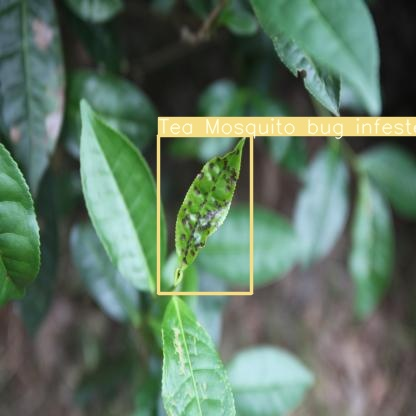

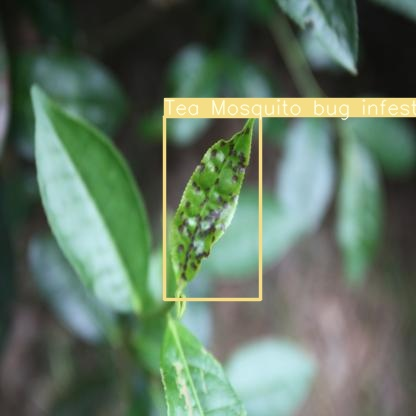

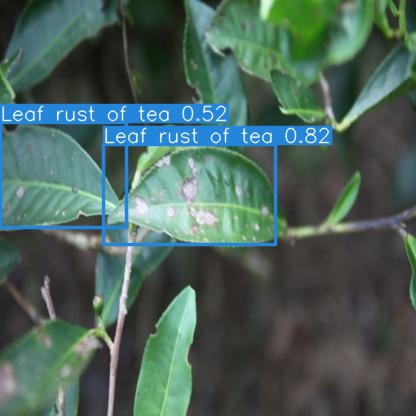

In [ ]:
%cd /content/gdrive/MyDrive/yolov7/yolov7
import glob
from IPython.display import Image, display

for imageName in glob.glob('runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")